# Robust PCA by Principal Component Pursuit

# Brief Explaination
Robust PCP (Principal Component Pursuit) is a method for structured signal recovery.

Given a data matrix $D \in \mathbb{R}^{n \times m} = L + S$ where $L$ is low rank and $S$ is sparse (with gross errors), Robust PCP finds estimates $\hat{L}, \hat{S}$ of $L, S$.

![image](pcp.png)

Under certain conditions, the PCP estimates $\hat{L}, \hat{S}$ solving
$$
\min \vert\vert L \vert\vert_{*} + \vert\vert S \vert\vert_{1} \\
\text{subject to } D = L + S
$$
exactly recovers $L$ and $S$.

Conditions ensure that

1. The low rank matrix L is not sparse
  * This is accomplished with an assumption of $\mu$-incoherence on the low rank matrix, which asserts that $L = USV^T$ satisfies (with r = rank(L)):
    * $max_i \vert\vert U^T e_i \vert\vert^2 \leq \frac{\mu r}{n}$
    * $max_i \vert\vert V^T e_i \vert\vert^2 \leq \frac{\mu r}{m}$
    * $max_i \vert\vert UV^T \vert\vert_\infty \leq \sqrt{\frac{\mu r}{n m}}$

2. The sparse matrix is not low rank
  * This is accomplished by assuming the sparsity pattern of the sparse component is selected uniformly at random.
  
Theoretical results show that there is a constant $c$ such that with probability at least $1 - cn^{-10}$ over the choice of support of $S$, PCP is exact with $\hat{L} = L, \hat{S} = S$ provided that $rank(L) \leq p_r n \mu^{-1} (\log n)^{-2}$ and $m \leq p_s n^2$ where $p_r, p_s$ are positive constants, $m$ is the cardinality of the support of $S$. (For the square case, similar but more verbose results exist for non square).

# Simulation Data

## A - situation which will work well

### 1. Describe the sampling/generative distributions
We generate random matricies $D$ by summing a low rank matrix $L$ and a sparse matrix $S$.

1. Sampling low rank matricies.
  * We first sample a matrix $P$ uniformally from $[0, 1]^{m \times d}$.
  * We then stack 5000 samples from $\mathcal{N}_3(\vec{0}, I_{d\times d})$ to get $G \in \mathbb{R}^{d \times n}$
  * We then form our low rank matrix $L = MD \in \mathbb{R}^{m \times n}$
  
2. Sampling sparse matricies.
  * Vectorize m samples from $Bernoulli(.1)$ to form a vector in $\mathbb{B}^{m}$, column stack n such samples to recieve $M \in \mathbb{B}^{m \times n}$
  * Use M to mask a matrix $D$ which contains n samples from $\mathcal{N}_{m}(\vec{0}, 100 * I_{m \times m})$ in its columns, call this matrix S.
  
3. Sum $D = S + L$. Since L is low rank and not sparse while S is sparse while not low rank, we expect the algorithm to recover $S$ and $L$.

### 2. Code to sample from distribution described in 1

In [1]:
import numpy as np
def get_data_A(d, m, n, p):
    P = np.random.uniform(0, 1, m*d).reshape(m, d)
    G = np.random.multivariate_normal([0] * d, np.eye(d), n).T
    L_A = P.dot(G)

    M_A = np.random.binomial(1, p, m*n).reshape(m, n)
    S_A = np.random.multivariate_normal(np.zeros(m),
                                      100 * np.eye(m),
                                      n).T
    S_A[M_A == 0] = 0
    D_A = L_A + S_A
    return G, M_A, L_A, S_A, D_A
d = 3
m = 50
n = 500
p = .1
G, M_A, L_A, S_A, D_A = get_data_A(d, m, n, p)

### 3. Describe what the simulations should look like
* The observations from the latent distribution $G$ should look like samples from a 3d Gaussian (a sphere cloud).


* The low rank matrix L constructed by projecting these samples into the subspace P should look like data points lying on a 300 dimensional linear space. 


* The masking matrix M should be a high-rank binary matrix


* The sparse matrix S should be high rank with only roughly 1/10 non-zero values, and these values should be large in magnitude.


* The matrix D should look similar to the low rank matrix L with 1/10 of the values being gross outliers.


### 4. Code to plot simulated data

In [1]:
import plotly.plotly as py
import plotly.graph_objs as go
from plotly.offline import (download_plotlyjs,
                            init_notebook_mode,
                            plot,
                            iplot)
init_notebook_mode()
# 3d gaussian plot
def plot_3d(G, title):
    trace1 = go.Scatter3d(
        x=G[0, :],
        y=G[1, :],
        z=G[2, :],
        mode='markers',
        marker=dict(
            size=2,
            opacity=0.8
        )
    )

    data = [trace1]
    layout = go.Layout(
        title = title
    )
    fig = go.Figure(data=data, layout=layout)
    iplot(fig)
    
def plot_heat(M, title):
    data = [
        go.Heatmap(
            z = M
        )
    ]
    layout = go.Layout(
        title = title
    )
    fig = go.Figure(data=data, layout=layout)
    iplot(fig)

def plot_princ(D, title):
    U, s, _ = np.linalg.svd(D, full_matrices = False)
    D = U[:, :3].T.dot(D)
    plot_3d(D, title)

### 5. Plot the simulated data

In [3]:
plot_3d(G, 'n samples from latent distribution (3D normal)')
plot_heat(L_A, 'Heatmap of n samples from data distribution')
plot_heat(M_A, 'Masking Matrix')
plot_heat(S_A, 'Sparse Matrix')

### 6. Discuss correctness
* The latent samples look like a spherical point cloud, which is expected from a 3d multivariate normal.


* The low rank samples appear to be described well by the top 3 principal components.


* The masking matrix looks sparse and appears to be high rank


* The sparse matrix is indeed sparse and has gross outliers compared to the multivariate normal.

## B - situation which will not work well.

Here, we will make our low rank matrix also sparse.

### 1. Describe the sampling/generative distributions
We generate random matricies $D$ by summing a low rank sparse matrix $L$ and a sparse low rank matrix $S$.

1. Sampling low rank matricies.
  * We first sample a matrix $P$ uniformally from $[0, 1]^{m \times d}$.
  * Vectorize m samples from $Bernoulli(.1)$ to form a vector in $\mathbb{B}^{m}$, column stack n such samples to recieve $M \in \mathbb{B}^{m \times n}$
  * We then stack n samples from $\mathcal{N}_3(\vec{0}, I_{d\times d})$ to get $G \in \mathbb{R}^{d \times n}$
  * We then form our low rank matrix $L = MD \in \mathbb{R}^{m \times n}$
  * We then randomly mask 9/10 of the dimensions
  
  
2. Sampling sparse matricies.
  * Vectorize m samples from $Bernoulli(.1)$ to form a vector in $\mathbb{B}^{m}$, column stack n such samples to recieve $M \in \mathbb{B}^{m \times n}$
  * Use M to mask a matrix $D$ which contains 5000 samples from $\mathcal{N}_{m}(\vec{0}, 100 * I_{m \times m})$ in its columns, call this matrix S.
  
3. Sum $D = S + L$. Since L is low rank and sparse, we do not expect the separation to work well.

### 2. Code to sample from distribution described in 1

In [4]:
import numpy as np
def get_data_B(d, m, n, p):
    P = np.random.uniform(0, 1, m*d).reshape(m, d)
    G = np.random.multivariate_normal([0] * d, np.eye(d), n).T
    L_B = P.dot(G)
    mask = np.random.uniform(0, 1, m) > 0.9
    L_B[mask == 0, :] = 0 

    M_B = np.random.binomial(1, p, m*n).reshape(m, n)
    S_B = np.random.multivariate_normal(np.zeros(m),
                                      100 * np.eye(m),
                                      n).T
    S_B[M_B == 0] = 0
    D_B = L_B + S_B
    return G, M_B, L_B, S_B, D_B
d = 3
m = 50
n = 500
p = .1
G, M_B, L_B, S_B, D_B = get_data_B(d, m, n, p)

### 3. How should the data look?
Should look the same as in A, except the L matrix should be sparse and low rank.

### 4. Code to plot simulated data
same as in part A

### 5. Plot simulated data

In [5]:
plot_3d(G, 'n samples from latent distribution (3D normal)')
plot_heat(L_B, 'Heatmap of n samples from data distribution')
plot_heat(M_B, 'Masking Matrix')
plot_heat(S_B, 'Sparse Matrix')

### 6. This looks correct with respect to the prediction in 3.

# Simulation Analysis
### 1. Pseudocode
![image](pcp_alg.png)

### 2. Algorithm Code

In [6]:
import time
import fbpca
import logging
import numpy as np
from scipy.sparse.linalg import svds


def pcp(M, delta=1e-6, mu=None, maxiter=500, verbose=False, missing_data=True,
        svd_method="approximate", **svd_args):
    # Check the SVD method.
    allowed_methods = ["approximate", "exact", "sparse"]
    if svd_method not in allowed_methods:
        raise ValueError("'svd_method' must be one of: {0}"
                         .format(allowed_methods))

    # Check for missing data.
    shape = M.shape
    if missing_data:
        missing = ~(np.isfinite(M))
        if np.any(missing):
            M = np.array(M)
            M[missing] = 0.0
    else:
        missing = np.zeros_like(M, dtype=bool)
        if not np.all(np.isfinite(M)):
            logging.warn("The matrix has non-finite entries. "
                         "SVD will probably fail.")

    # Initialize the tuning parameters.
    lam = 1.0 / np.sqrt(np.max(shape))
    if mu is None:
        mu = 0.25 * np.prod(shape) / np.sum(np.abs(M))
        if verbose:
            print("mu = {0}".format(mu))

    # Convergence criterion.
    norm = np.sum(M ** 2)

    # Iterate.
    i = 0
    rank = np.min(shape)
    S = np.zeros(shape)
    Y = np.zeros(shape)
    while i < max(maxiter, 1):
        # SVD step.
        strt = time.time()
        u, s, v = _svd(svd_method, M - S + Y / mu, rank+1, 1./mu, **svd_args)
        svd_time = time.time() - strt

        s = shrink(s, 1./mu)
        rank = np.sum(s > 0.0)
        u, s, v = u[:, :rank], s[:rank], v[:rank, :]
        L = np.dot(u, np.dot(np.diag(s), v))

        # Shrinkage step.
        S = shrink(M - L + Y / mu, lam / mu)

        # Lagrange step.
        step = M - L - S
        step[missing] = 0.0
        Y += mu * step

        # Check for convergence.
        err = np.sqrt(np.sum(step ** 2) / norm)
        if verbose:
            print(("Iteration {0}: error={1:.3e}, rank={2:d}, nnz={3:d}, "
                   "time={4:.3e}")
                  .format(i, err, np.sum(s > 0), np.sum(S > 0), svd_time))
        if err < delta:
            break
        i += 1

    #if i >= maxiter:
        #logging.warn("convergence not reached in pcp")
    return L, S, (u, s, v)


def shrink(M, tau):
    sgn = np.sign(M)
    S = np.abs(M) - tau
    S[S < 0.0] = 0.0
    return sgn * S


def _svd(method, X, rank, tol, **args):
    rank = min(rank, np.min(X.shape))
    if method == "approximate":
        return fbpca.pca(X, k=rank, raw=True, **args)
    elif method == "exact":
        return np.linalg.svd(X, full_matrices=False, **args)
    elif method == "sparse":
        if rank >= np.min(X.shape):
            return np.linalg.svd(X, full_matrices=False)
        u, s, v = svds(X, k=rank, tol=tol)
        u, s, v = u[:, ::-1], s[::-1], v[::-1, :]
        return u, s, v
    raise ValueError("invalid SVD method")

### 3. Algorithm performance
This algorithm should perform well on the first data set (set A) but should perform poorly on the second data set (set B).

### 4. Generate simulation data

In [7]:
_, _, L_A, S_A, D_A = get_data_A(d, m, n, p)
_, _, L_B, S_B, D_B = get_data_B(d, m, n, p)

### 5. Run the algorithm on simulated data

In [8]:
L_A_hat, S_A_hat, _ = pcp(D_A,
                          maxiter=100,
                          verbose=False, 
                          svd_method="approximate")
L_B_hat, S_B_hat, _ = pcp(D_B,
                          maxiter=100,
                          verbose=False, 
                          svd_method="approximate")

### 6. Plot results

In [9]:
plot_heat(L_A_hat - L_A, 'Difference of L and L_hat for A')
plot_heat(S_A_hat - S_A, 'Difference of S and S_hat for A')
plot_heat(L_B_hat - L_B, 'Difference of L and L_hat for B')
plot_heat(S_B_hat - S_B, 'Difference of S and S_hat for B')

### 7. Metric for evaluation
We will take the frobenius norm of the difference of $L, \hat{L}$ and the difference between $S, \hat{S}$ for each dataset.

### 8. Metric Code

In [10]:
def quantify(L_A, S_A, L_B, S_B, L_Ah, S_Ah, L_Bh, S_Bh):
    print "L diff for A:", np.linalg.norm(L_A - L_Ah)
    print "L diff for B:", np.linalg.norm(L_B - L_Bh)
    print "S diff for A:", np.linalg.norm(S_A - S_Ah)
    print "S diff for B:", np.linalg.norm(S_B - S_Bh)
    
def q2(L_A, S_A, L_B, S_B, L_Ah, S_Ah, L_Bh, S_Bh):
    return (np.linalg.norm(L_A - L_Ah),
           np.linalg.norm(L_B - L_Bh),
           np.linalg.norm(S_A - S_Ah),
           np.linalg.norm(S_B - S_Bh))
        
quantify(L_A, S_A, L_B, S_B,
         L_A_hat, S_A_hat, L_B_hat, S_B_hat)

L diff for A: 0.00180077534031
L diff for B: 10.9776144014
S diff for A: 0.00557249712557
S diff for B: 10.9776166776


### 9. Repeat 10x

In [11]:
for i in range(10):
    d = 3 + int(np.random.random() * 4 - 2)
    m = 50 + int(np.random.random() * 10 - 5)
    n = 500 + int(np.random.random() * 200 - 100)
    p = .1 + int(np.random.random() * .1 - .05)
    _, _, L_A, S_A, D_A = get_data_A(d, m, n, p)
    _, _, L_B, S_B, D_B = get_data_B(d, m, n, p)
    L_A_hat, S_A_hat, _ = pcp(D_A,
                          maxiter=300,
                          verbose=False, 
                          svd_method="approximate")
    L_B_hat, S_B_hat, _ = pcp(D_B,
                          maxiter=300,
                          verbose=False, 
                          svd_method="approximate")
    plot_heat(L_A_hat - L_A, 'Difference of L and L_hat for A')
    plot_heat(S_A_hat - S_A, 'Difference of S and S_hat for A')
    plot_heat(L_B_hat - L_B, 'Difference of L and L_hat for B')
    plot_heat(S_B_hat - S_B, 'Difference of S and S_hat for B')
    quantify(L_A, S_A, L_B, S_B,
         L_A_hat, S_A_hat, L_B_hat, S_B_hat)

L diff for A: 0.000352946388055
L diff for B: 21.1462430611
S diff for A: 0.0001294087515
S diff for B: 21.1461646626


L diff for A: 0.00021774471
L diff for B: 16.9177747846
S diff for A: 7.02402436004e-05
S diff for B: 16.91779427


L diff for A: 0.000540494525761
L diff for B: 22.7146628496
S diff for A: 0.00020023907503
S diff for B: 22.7146664296


L diff for A: 0.000596842481408
L diff for B: 21.3324393628
S diff for A: 0.000273623059786
S diff for B: 21.332439356


L diff for A: 0.000736119328111
L diff for B: 26.4782593906
S diff for A: 0.000517799941001
S diff for B: 26.4782573499


L diff for A: 0.00040655688661
L diff for B: 14.4679923936
S diff for A: 0.000154312848075
S diff for B: 14.4679924518


L diff for A: 0.000441999493195
L diff for B: 26.6334626434
S diff for A: 0.000154958826664
S diff for B: 26.6334285274


L diff for A: 0.000369251709269
L diff for B: 19.3964757968
S diff for A: 0.00014174339185
S diff for B: 19.3964829161


L diff for A: 0.0163622569496
L diff for B: 15.8011959275
S diff for A: 0.0163555488032
S diff for B: 15.8012430967


L diff for A: 0.000208872305307
L diff for B: 14.5783893096
S diff for A: 6.65841995346e-05
S diff for B: 14.5783886508


# Simulation Analysis
Here we run many experiments and test the metric to see how well our algorithm does on case A and poorly on case B.

### 1. Describe visualization
We will visualize by running many tests of case A and case B then creating histograms of the metric (frobenius norm) explained in the previous section.

### 2. Describe how we will compute performance.
We will find the difference between the simulation means (A and B) of the low rank and sparse matricies.

### 3. Plotting Code

In [12]:
import matplotlib.pyplot as plt
import seaborn as sns
def plot_qualitative(LA, SA, LB, SB):
    sns.distplot(LA, label= "Low Rank, Simulation A")
    sns.distplot(SA, label= "Sparse, Simulation A")
    plt.legend()
    plt.title("Frobenius Norm errors for simulation A")
    plt.show()
    sns.distplot(LB, label= "Low Rank, Simulation B")
    sns.distplot(SB, label= "Sparse, Simulation B")
    plt.legend()
    plt.title("Frobenius Norm errors for simulation B")
    plt.show()

### 4. Quantitative Code

In [13]:
def quantitative(LA, SA):
    DL = np.mean(LA)
    DS = np.mean(SA)
    return DL, DS

### 5. Run qualitative population analysis

In [14]:
LA = []
LB = []
SA = []
SB = []
for i in range(50):
    d = 3 + int(np.random.random() * 2 - 1)
    m = 100 + int(np.random.random() * 10 - 5)
    n = 1000 + int(np.random.random() * 200 - 100)
    p = .1 + int(np.random.random() * .1 - .05)
    _, _, L_A, S_A, D_A = get_data_A(d, m, n, p)
    _, _, L_B, S_B, D_B = get_data_B(d, m, n, p)
    L_A_hat, S_A_hat, _ = pcp(D_A,
                          maxiter=200,
                          verbose=False, 
                          svd_method="approximate")
    L_B_hat, S_B_hat, _ = pcp(D_B,
                          maxiter=200,
                          verbose=False, 
                          svd_method="approximate")
    L_A, L_B, S_A, S_B = q2(L_A, S_A, L_B, S_B,
         L_A_hat, S_A_hat, L_B_hat, S_B_hat)
    LA.append(L_A)
    LB.append(L_B)
    SA.append(S_A)
    SB.append(S_B)
    

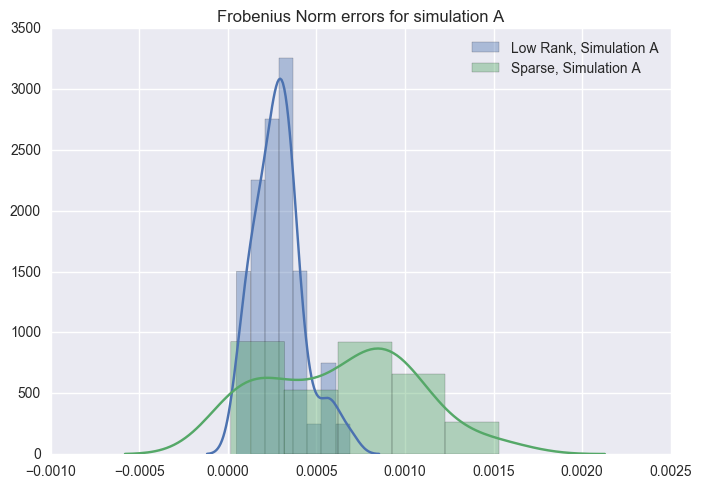

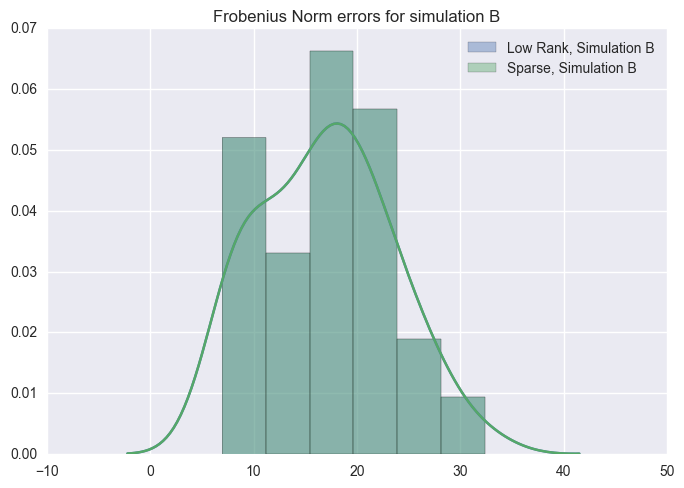

In [15]:
plot_qualitative(LA, SA, LB, SB)

### 7. Compute Quantitative

In [16]:
DL, DS = quantitative(LA, SA)
print 'L_A mean:', DL, 'S_A mean:', DS
DL, DS = quantitative(LB, SB)
print 'L_B mean:', DL, 'S_B mean:', DS

L_A mean: 0.000285572043631 S_A mean: 0.000639351953183
L_B mean: 16.9170333805 S_B mean: 16.9170321101


# Real Data Analysis
### 1. Find two data sets
We will use image data sets, since we can then visually see what the algorithm is doing. Also, it is known (hypothesized?) that many natural images can be modelled by overcomplete bases (e.g. sum of low rank and sparse components).

1. The Yale Faces data set
2. The Cifar-10 data set

### 2. Describe the data sets
1. Yale Faces
  * 5760 samples of 640 x 480 images of faces with different illuminations
2. CIFAR-10
  * 10,000 32 x 32 RGB images of real-world objects and scenes (boats, cars, animals, ect.).

### 3. Plot Raw Data
 * Raw data is shown in the leftmost images
 
### 4. Predict Performance Accuracy
  * There is no numerical accuracy associated with this data set.
  * Accuracy will be judged by how well the algorithm removes sparse and detailed features, e.g. shadows, currogation in the wall, glares, oily parts of face, details in hair. Same with the natural objects, except details will vary based on which object.

### 5. Run Same Code
  * The results of the pcp algorithm L and R will be shown in order to the right of the original.
 
ORIGINAL | LOW RANK | SPARSE

In [17]:
import os
from PIL import Image
trials = []
for f_name in os.listdir('yalefaces')[:10]:
    og = Image.open('yalefaces/' + f_name)
    og = np.array(og)
    L, S, _ = pcp(og,
                  maxiter=200,
                  verbose=False, 
                  svd_method="approximate")
    trial = np.hstack([og, L, S])
    trials.append(trial)
    
full = np.vstack(trials)

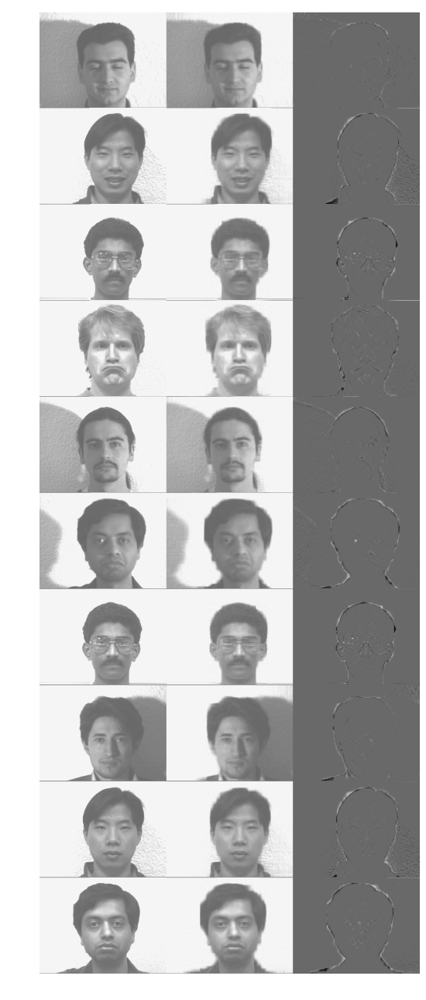

In [18]:
%matplotlib inline
import matplotlib.pylab as pylab
pylab.rcParams['figure.figsize'] = 12, 16
plt.imshow(full, 'gray')
plt.axis('off')
plt.show()

In [19]:
def unpickle(f_name):
    import cPickle
    fo = open(f_name, 'rb')
    dct = cPickle.load(fo)
    fo.close()
    return dct
data = unpickle('cifar-10-batches-py/data_batch_1')


In [20]:
from PIL import Image
trials = []
for img in data['data'][:10]:
    og = img[1024:2048].reshape(32, 32)
    L, S, _ = pcp(og,
                  maxiter=300,
                  verbose=False, 
                  svd_method="approximate")
    trial = np.hstack([og, L, S])
    trials.append(trial)
    
full = np.vstack(trials)

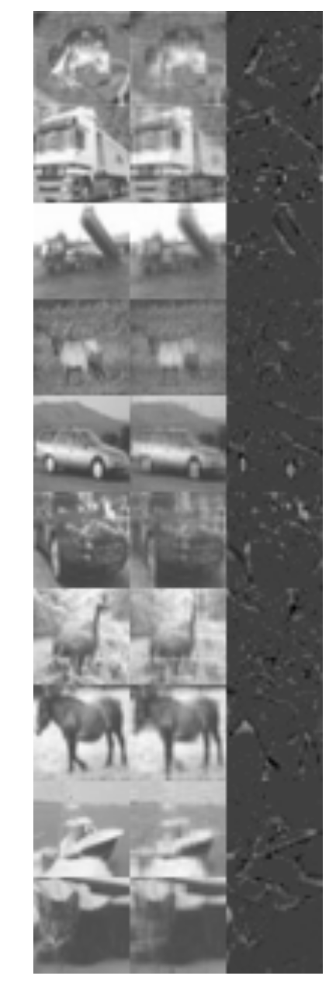

In [21]:
plt.imshow(full, 'gray')
plt.axis('off')
plt.show()

### 6. Conclusion of Real Data Experiment
* The Yale Faces Experiment
  * While to numerical metric can tells us how much 'better' the algorithm made the faces, it seems clear that the algorithm is successfully separating the image a low rank image which captures smooth regions, and a sparse image which captures the details such as glare, background noise, shadows, face border noise, and so on. These results appear similar to those in the original paper https://arxiv.org/pdf/0912.3599v1.pdf.
  
* The CIFAR-10 Experiment
  * The results here are less clear. It appears that mostly the optlines of objects, and some glares and bright areas, are captured by the sparse matrix. Perhaps since the image quality is quite low as compared to the face data, we are able to see less of the separation. It is likely that this image set has a higher rank to dimension ratio, so it makes sense that the algorithm may work poorly.
 